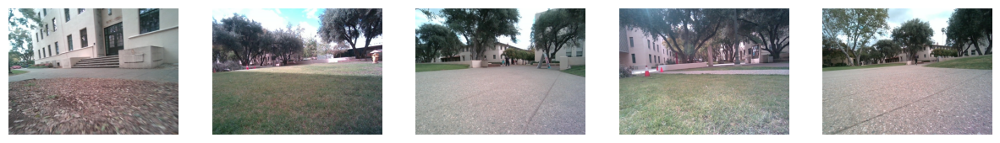

nb of images in the dataset:  63


In [1]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt


from src.tools import check_file_path
dataset_folder = 'datasets/dataset-2024-04-25_14-58-19'
valid_folder = check_file_path(dataset_folder, "test")
valid_folder_manually = os.path.join(dataset_folder,'test_manually_labelled')

imaege_folder = check_file_path(valid_folder,"rgb")
# Get a list of image files in the dataset folder
image_files = [check_file_path(imaege_folder, file) for file in os.listdir(imaege_folder) if file.endswith('.jpg')]
np.random.shuffle(image_files)
# Plot the first few images
num_images_to_plot = 5
fig, axes = plt.subplots(1, num_images_to_plot, figsize=(15, 3))

for i in range(num_images_to_plot):
    image = Image.open( image_files[i])
    axes[i].imshow(image)
    axes[i].axis('off')

plt.show()
print("nb of images in the dataset: ", len(image_files))


In [2]:
import os
from transformers import OneFormerProcessor, OneFormerForUniversalSegmentation
import torch
from src.tools import clear_folder
from src.tools import filename_to_timestamp
batch_size = 4
# Define the folder paths

clear_folder(valid_folder_manually)
valid_rgb_segmented_folder = os.path.join(valid_folder_manually,'rgb_segmented_color')
valid_masks_folder = os.path.join(valid_folder_manually,'rgb_segmented_label')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
class ImageDataset(torch.utils.data.Dataset):
  'Characterizes a dataset for PyTorch'
  def __init__(self, filename):
        'Initialization'
        self.filename = filename

  def __len__(self):
        'Denotes the total number of samples'
        return len(self.filename)

  def __getitem__(self, index):
        'Generates one sample of data'
        # Select sample
        image = Image.open(self.filename[index])
        timestamp = filename_to_timestamp(os.path.basename(self.filename[index]))
        return np.array(image), timestamp

processor = OneFormerProcessor.from_pretrained("shi-labs/oneformer_ade20k_swin_large")
model = OneFormerForUniversalSegmentation.from_pretrained("shi-labs/oneformer_ade20k_swin_large")
model = model.to(device)

image_set = ImageDataset(image_files)
dataloader = torch.utils.data.DataLoader(image_set, batch_size=batch_size, shuffle=False,num_workers=0, pin_memory=True)

id_to_label_name = {
  "0": "wall",
  "1": "building",
  "2": "sky",
  "3": "floor",
  "4": "tree",
  "5": "ceiling",
  "6": "road",
  "7": "bed ",
  "8": "windowpane",
  "9": "grass",
  "10": "cabinet",
  "11": "sidewalk",
  "12": "person",
  "13": "earth",
  "14": "door",
  "15": "table",
  "16": "mountain",
  "17": "plant",
  "18": "curtain",
  "19": "chair",
  "20": "car",
  "21": "water",
  "22": "painting",
  "23": "sofa",
  "24": "shelf",
  "25": "house",
  "26": "sea",
  "27": "mirror",
  "28": "rug",
  "29": "field",
  "30": "armchair",
  "31": "seat",
  "32": "fence",
  "33": "desk",
  "34": "rock",
  "35": "wardrobe",
  "36": "lamp",
  "37": "bathtub",
  "38": "railing",
  "39": "cushion",
  "40": "base",
  "41": "box",
  "42": "column",
  "43": "signboard",
  "44": "chest of drawers",
  "45": "counter",
  "46": "sand",
  "47": "sink",
  "48": "skyscraper",
  "49": "fireplace",
  "50": "refrigerator",
  "51": "grandstand",
  "52": "path",
  "53": "stairs",
  "54": "runway",
  "55": "case",
  "56": "pool table",
  "57": "pillow",
  "58": "screen door",
  "59": "stairway",
  "60": "river",
  "61": "bridge",
  "62": "bookcase",
  "63": "blind",
  "64": "coffee table",
  "65": "toilet",
  "66": "flower",
  "67": "book",
  "68": "hill",
  "69": "bench",
  "70": "countertop",
  "71": "stove",
  "72": "palm",
  "73": "kitchen island",
  "74": "computer",
  "75": "swivel chair",
  "76": "boat",
  "77": "bar",
  "78": "arcade machine",
  "79": "hovel",
  "80": "bus",
  "81": "towel",
  "82": "light",
  "83": "truck",
  "84": "tower",
  "85": "chandelier",
  "86": "awning",
  "87": "streetlight",
  "88": "booth",
  "89": "television receiver",
  "90": "airplane",
  "91": "dirt track",
  "92": "apparel",
  "93": "pole",
  "94": "land",
  "95": "bannister",
  "96": "escalator",
  "97": "ottoman",
  "98": "bottle",
  "99": "buffet",
  "100": "poster",
  "101": "stage",
  "102": "van",
  "103": "ship",
  "104": "fountain",
  "105": "conveyer belt",
  "106": "canopy",
  "107": "washer",
  "108": "plaything",
  "109": "swimming pool",
  "110": "stool",
  "111": "barrel",
  "112": "basket",
  "113": "waterfall",
  "114": "tent",
  "115": "bag",
  "116": "minibike",
  "117": "cradle",
  "118": "oven",
  "119": "ball",
  "120": "food",
  "121": "step",
  "122": "tank",
  "123": "trade name",
  "124": "microwave",
  "125": "pot",
  "126": "animal",
  "127": "bicycle",
  "128": "lake",
  "129": "dishwasher",
  "130": "screen",
  "131": "blanket",
  "132": "sculpture",
  "133": "hood",
  "134": "sconce",
  "135": "vase",
  "136": "traffic light",
  "137": "tray",
  "138": "ashcan",
  "139": "fan",
  "140": "pier",
  "141": "crt screen",
  "142": "plate",
  "143": "monitor",
  "144": "bulletin board",
  "145": "shower",
  "146": "radiator",
  "147": "glass",
  "148": "clock",
  "149": "flag"
}
# assign a color to each class
id_to_color={}
# set seed
np.random.seed(42)
for i in range(150):
    id_to_color[i] = np.hstack((np.random.rand(3),1))
print(id_to_color)

c:\Users\Gharib\Desktop\vincent\master_thesis_v2\venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\Gharib\Desktop\vincent\master_thesis_v2\venv\lib\site-packages\transformers\models\oneformer\image_processing_oneformer.py:446: FutureWarning: The `reduce_labels` argument is deprecated and will be removed in v4.27. Please use `do_reduce_labels` instead.
  warnings.warn(


{0: array([0.37454012, 0.95071431, 0.73199394, 1.        ]), 1: array([0.59865848, 0.15601864, 0.15599452, 1.        ]), 2: array([0.05808361, 0.86617615, 0.60111501, 1.        ]), 3: array([0.70807258, 0.02058449, 0.96990985, 1.        ]), 4: array([0.83244264, 0.21233911, 0.18182497, 1.        ]), 5: array([0.18340451, 0.30424224, 0.52475643, 1.        ]), 6: array([0.43194502, 0.29122914, 0.61185289, 1.        ]), 7: array([0.13949386, 0.29214465, 0.36636184, 1.        ]), 8: array([0.45606998, 0.78517596, 0.19967378, 1.        ]), 9: array([0.51423444, 0.59241457, 0.04645041, 1.        ]), 10: array([0.60754485, 0.17052412, 0.06505159, 1.        ]), 11: array([0.94888554, 0.96563203, 0.80839735, 1.        ]), 12: array([0.30461377, 0.09767211, 0.68423303, 1.        ]), 13: array([0.44015249, 0.12203823, 0.49517691, 1.        ]), 14: array([0.03438852, 0.9093204 , 0.25877998, 1.        ]), 15: array([0.66252228, 0.31171108, 0.52006802, 1.        ]), 16: array([0.54671028, 0.18485446

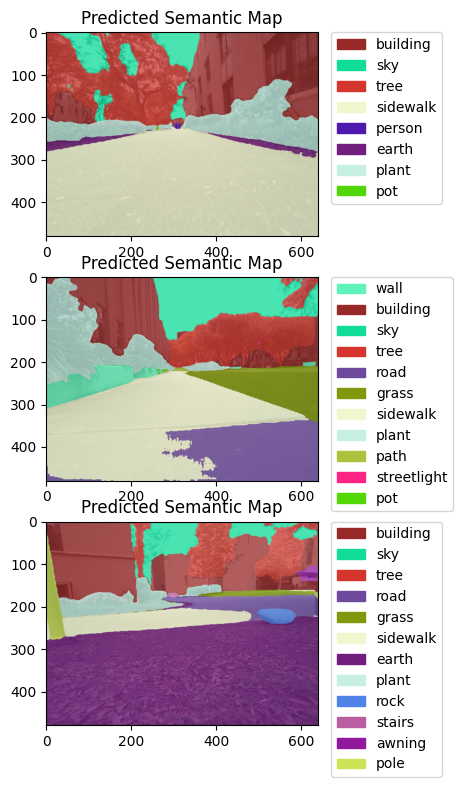

100%|██████████| 16/16 [00:31<00:00,  1.95s/it]


In [3]:

from tqdm import tqdm 
import matplotlib.patches as mpatches
from IPython.display import clear_output
%matplotlib inline
import time
def plot_predicted_semantic_map(input,image_label,ax):
    # Plot the predicted semantic map
    semantic_map_rgb = np.zeros((image_label.shape[0], image_label.shape[1], 3), dtype=np.uint8)
    unique_labels = np.unique(image_label)
    color=[id_to_color[label] for label in unique_labels]
    names=[id_to_label_name[str(label)] for label in unique_labels]
    patches = []
    for label_id,color,name in zip(unique_labels,color,names):
        semantic_map_rgb[image_label == label_id] = color[:3]*255
        patches.append(mpatches.Patch(color=color, label=name))
    ax.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
    ax.imshow(input)
    ax.imshow(semantic_map_rgb,alpha=0.75)
    ax.set_title("Predicted Semantic Map")
    return semantic_map_rgb



# Create the folders if they don't exist
clear_folder(valid_rgb_segmented_folder)
clear_folder(valid_masks_folder)

with torch.inference_mode():
    for data in tqdm(dataloader):
        images,timestamps=data
        inputs = processor(images, ["semantic" for _ in range(len(images))], return_tensors="pt")          
        outputs = model(**inputs.to(device))
        
        predicted_semantic_map = processor.post_process_semantic_segmentation(
            outputs, target_sizes=[images[0].shape[0:2] for i in range(images.shape[0])]
        )
        clear_output(wait=True)
        image_size = len(images)
        fig, ax = plt.subplots(image_size, 1, figsize=(5, 3*image_size))
        for i in range(image_size):
            image_rgb = plot_predicted_semantic_map(images[i],predicted_semantic_map[i].cpu().numpy(),ax[i])
            # save image in valid_rgb_segmented_folder
            image = Image.fromarray(image_rgb)
            image.save(os.path.join(valid_rgb_segmented_folder, f"{timestamps[i]}.png"))
            np.save(os.path.join(valid_masks_folder, f"{timestamps[i]}.npy"), predicted_semantic_map[i].cpu().numpy())
        plt.show()
        # time.sleep(1)

    
        # break
        # for p in predicted_semantic_map:
        #     trav_color_rgb, trav_count = np.unique(np.array(p.cpu()).reshape(-1), axis=0,return_counts=True)
        #     results.append([trav_color_rgb, trav_count])

In [4]:
label_files = [check_file_path(valid_masks_folder, file) for file in os.listdir(valid_masks_folder) if file.endswith('.npy')]
total_counts = np.ones(150)*0.0001
id_label = []
cot_counts = np.zeros(150)
cot_no_traversable = 8
for label_file in label_files:
    # print(label_file)
    labels = np.load(label_file)
    # mask_path = check_file_path(dataset_folder,"mask",os.path.basename(label_file))
    # print(mask_path)
    masks = np.load(check_file_path(valid_folder,"mask",os.path.basename(label_file)))
    labels_id = np.unique(labels)
    id_label.extend(labels_id)
    for label_id in labels_id:
        cots = masks[labels == label_id]
        cots = cots[(cots != 0) & (cots < cot_no_traversable)]
        if cots.size == 0:
            continue
        cots_unique, count = np.unique(cots, return_counts=True)
        for cot, c in zip(cots_unique, count):
            cot_counts[label_id] += c*cot
            total_counts[label_id] += c
    # print(cot_counts)
    # print(masks)
    # print(labels.shape)
    # print()
    # print(np.unique(masks))
# print(total_counts)
id_label = np.unique(id_label)
mean = cot_counts/total_counts
# print(mean[id_label])
for i in id_label:
    print(id_to_label_name[str(i)], mean[i], total_counts[i])


wall 1.019243308144868 284.0001
building 4.410614506946017 2793.0001
sky 0.0 0.0001
tree 0.0 0.0001
road 1.48557091374394 1397155.0001
grass 1.5966119129216023 2500363.0001
sidewalk 1.3947464663794744 4951523.0001
person 0.0 0.0001
earth 1.2738297112223491 408413.0001
door 0.0 0.0001
table 0.0 0.0001
mountain 0.0 0.0001
plant 1.2715752552351773 26.0001
chair 0.0 0.0001
car 0.0 0.0001
fence 0.0 0.0001
rock 1.3868944820340063 4.0001
lamp 0.0 0.0001
railing 0.0 0.0001
base 0.0 0.0001
column 0.0 0.0001
signboard 0.9497024946135523 3.0001
path 1.6607684580332056 1924.0001
stairs 1.986998027123373 4.0001
stairway 0.0 0.0001
bench 0.49999687501953116 16.0001
palm 0.0 0.0001
awning 0.0 0.0001
streetlight 0.0 0.0001
pole 0.0 0.0001
bannister 0.0 0.0001
minibike 0.0 0.0001
step 0.0 0.0001
tank 0.0 0.0001
pot 0.0 0.0001
bicycle 0.0 0.0001
sculpture 2.328168988062657 7.0001
sconce 0.0 0.0001
ashcan 0.0 0.0001
flag 0.0 0.0001


[6, 9, 11, 13, 52]
timestamp: 1712269366.877286.npy


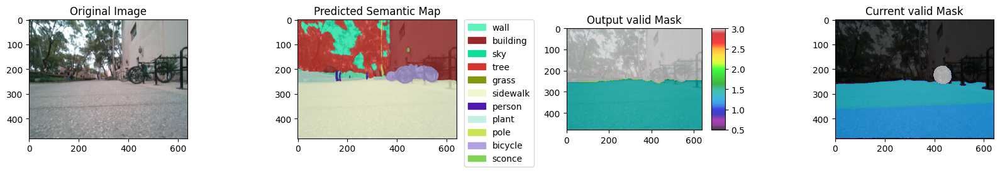

timestamp: 1712269377.913601.npy


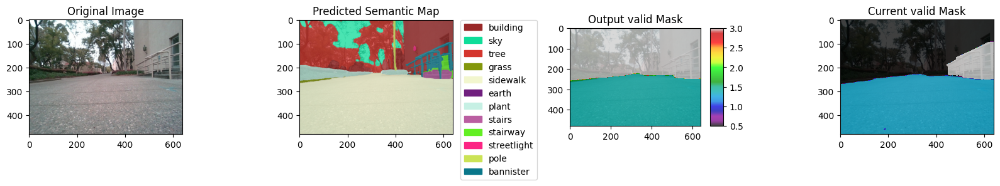

timestamp: 1712269380.415490.npy


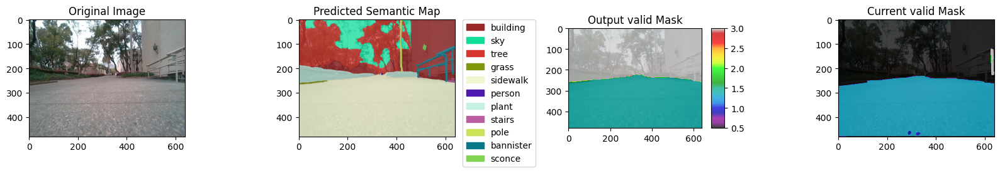

timestamp: 1712269385.517898.npy


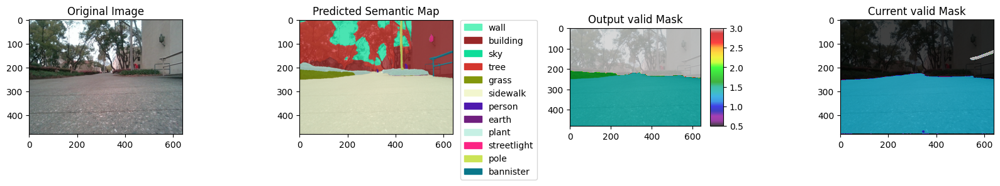

timestamp: 1712269398.223473.npy


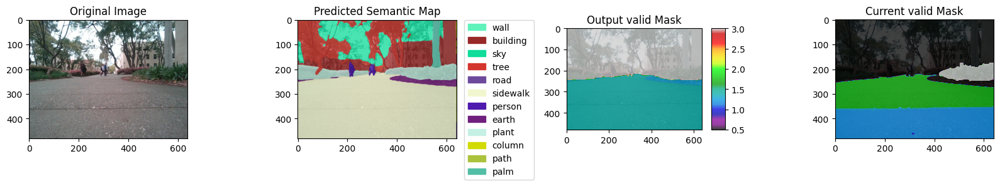

timestamp: 1712269408.360136.npy


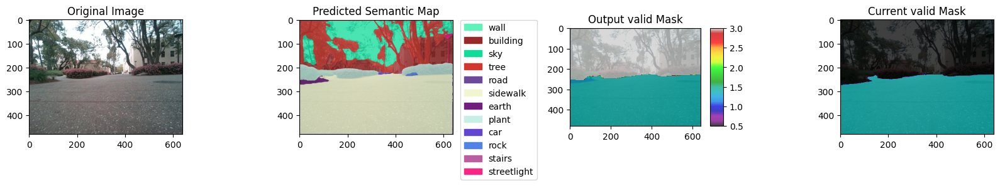

timestamp: 1712269431.503073.npy


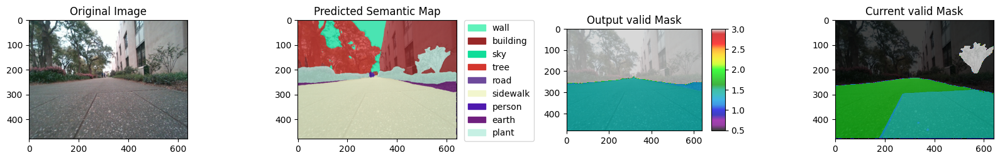

timestamp: 1712269432.603450.npy


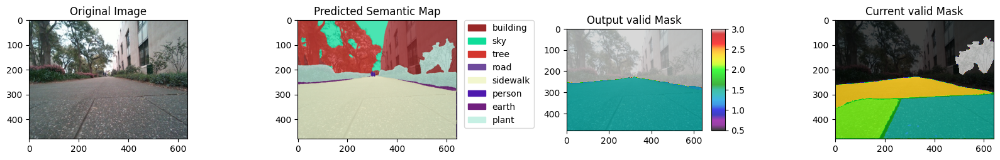

timestamp: 1712269442.440858.npy


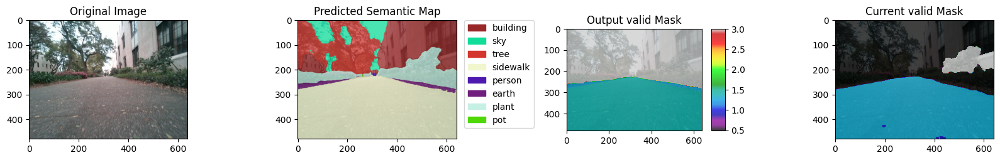

timestamp: 1712269460.848963.npy


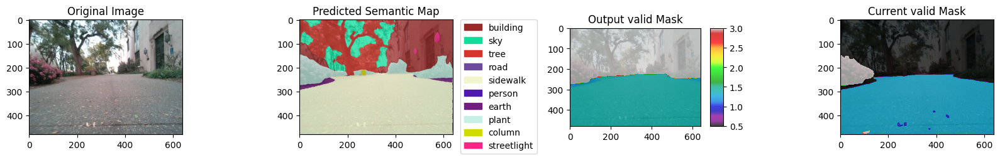

timestamp: 1712269464.883072.npy


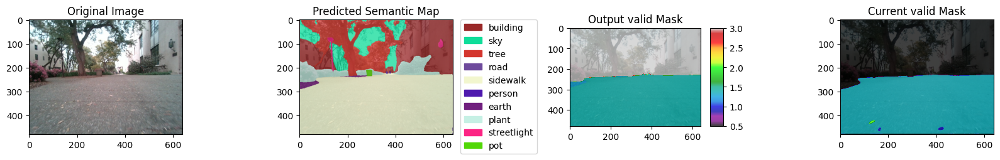

timestamp: 1712269473.056130.npy


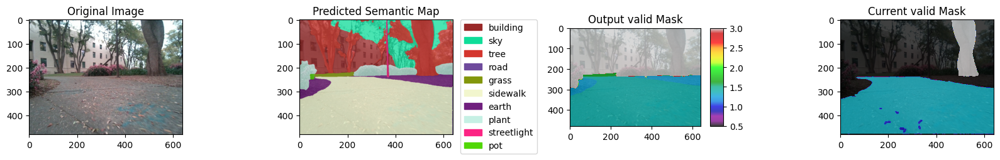

timestamp: 1712269508.200969.npy


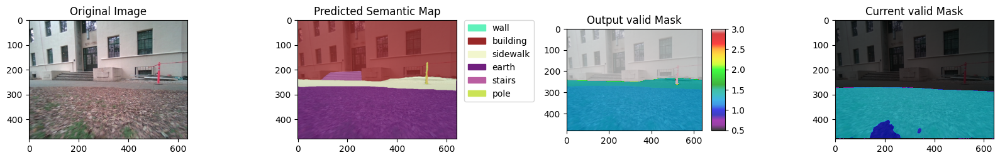

timestamp: 1712269511.035277.npy


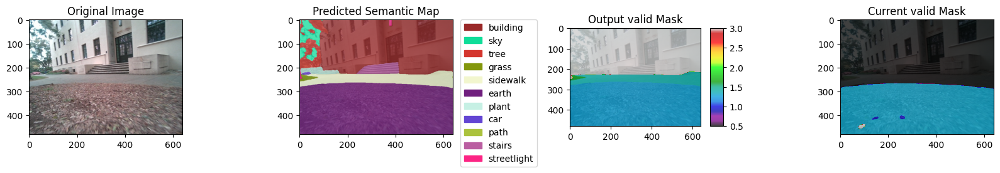

timestamp: 1712270350.378110.npy


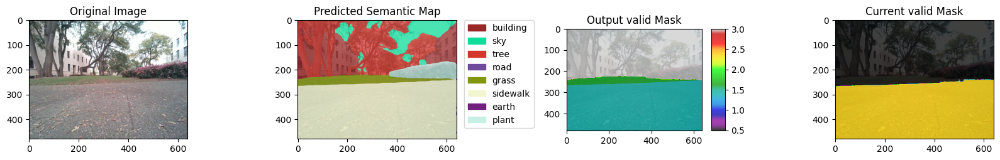

timestamp: 1712270352.845903.npy


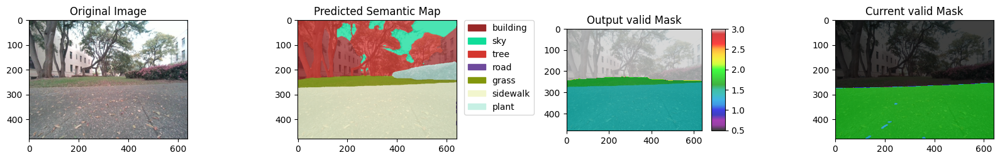

timestamp: 1712270355.013417.npy


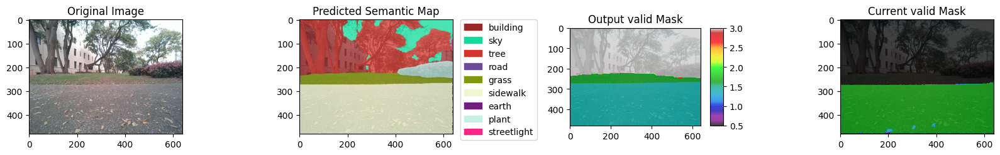

timestamp: 1712270385.860247.npy


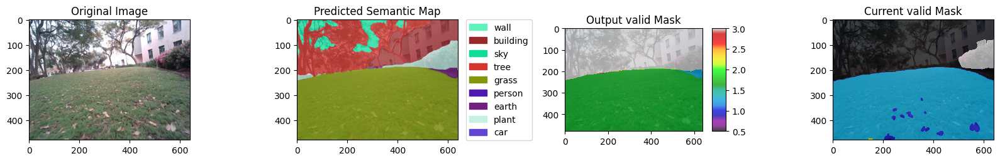

timestamp: 1712270393.107630.npy


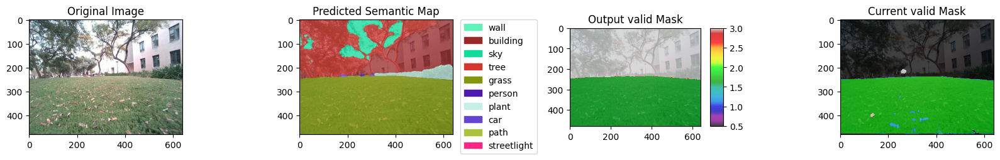

timestamp: 1712270419.552139.npy


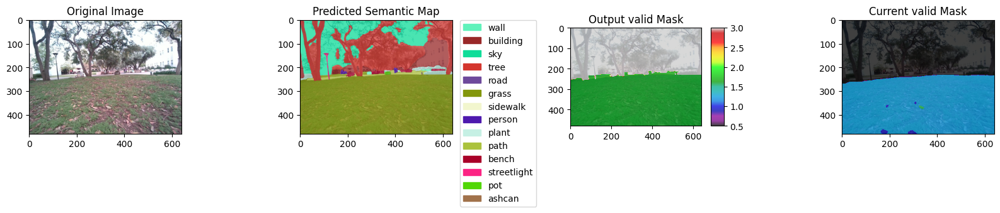

timestamp: 1712270423.319867.npy


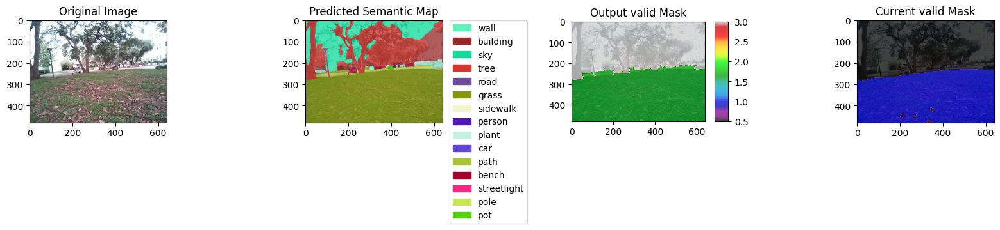

timestamp: 1712270436.225706.npy


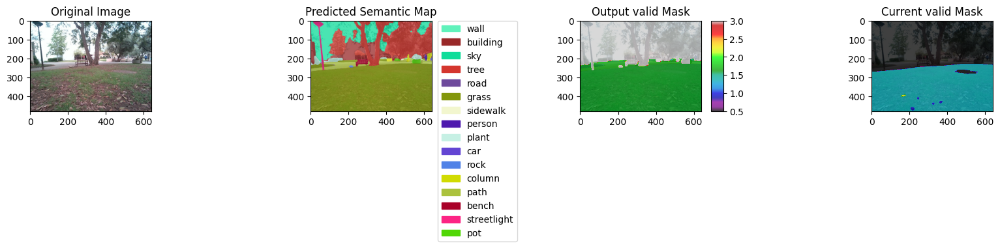

timestamp: 1712270441.194149.npy


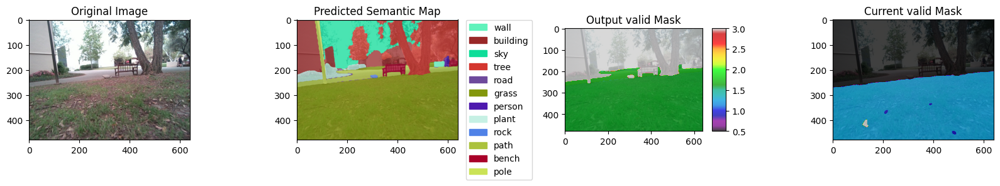

timestamp: 1712270448.197058.npy


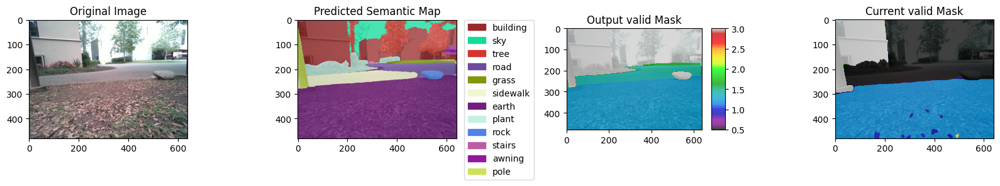

timestamp: 1712270455.567168.npy


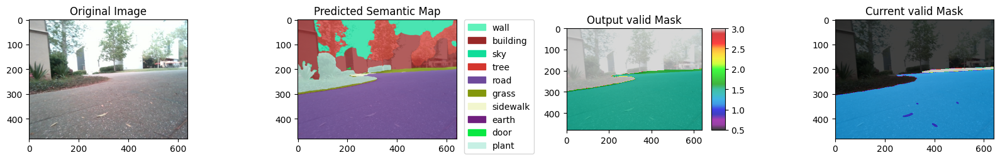

timestamp: 1712270458.735152.npy


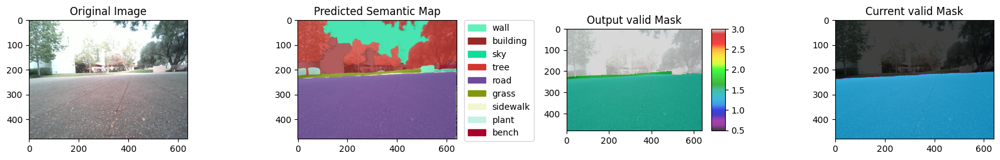

timestamp: 1712270463.003572.npy


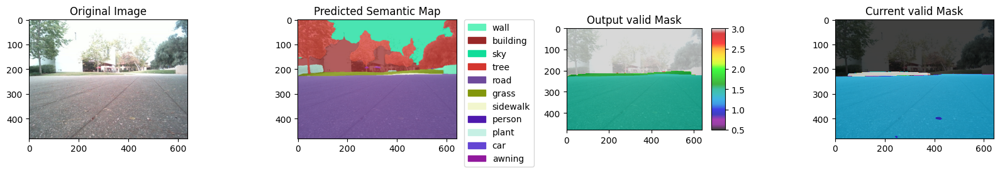

timestamp: 1712270490.409565.npy


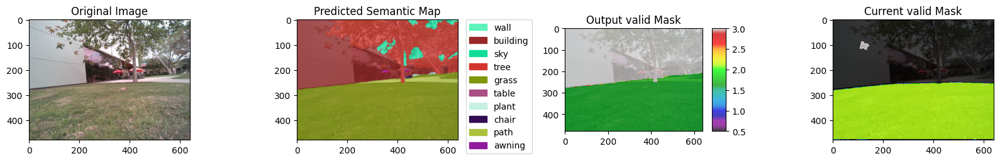

timestamp: 1712270491.847270.npy


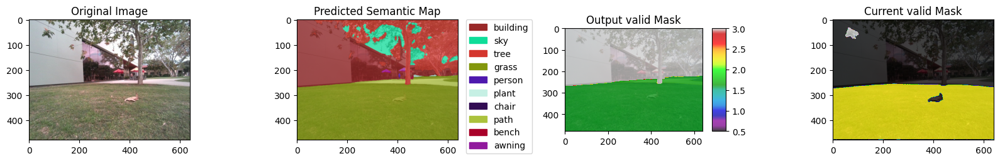

timestamp: 1712270496.282533.npy


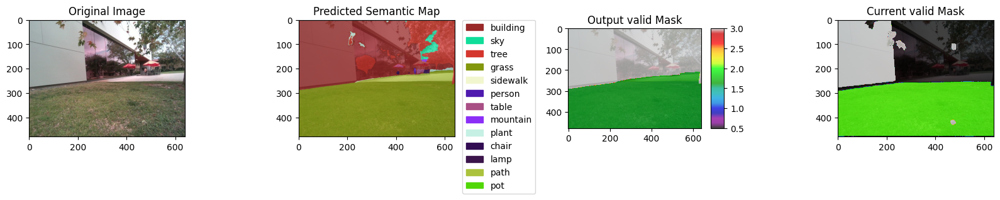

timestamp: 1712270497.315785.npy


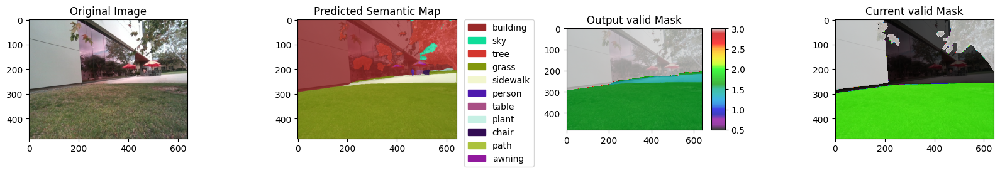

timestamp: 1712270502.420102.npy


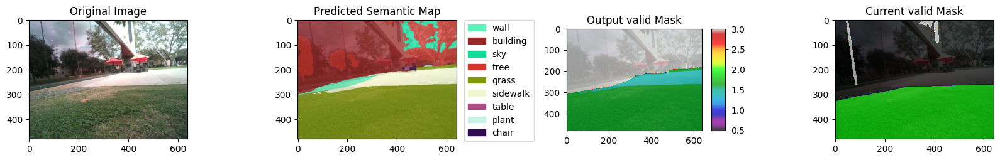

timestamp: 1712270517.928699.npy


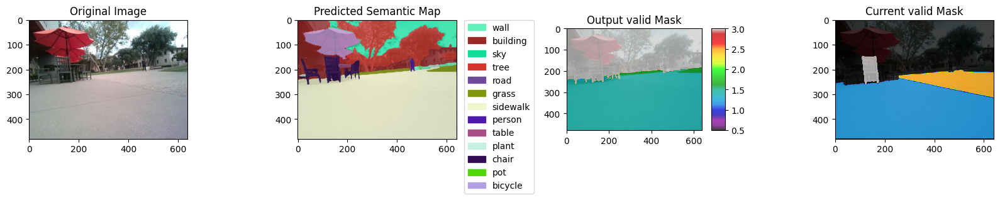

timestamp: 1712270520.196061.npy


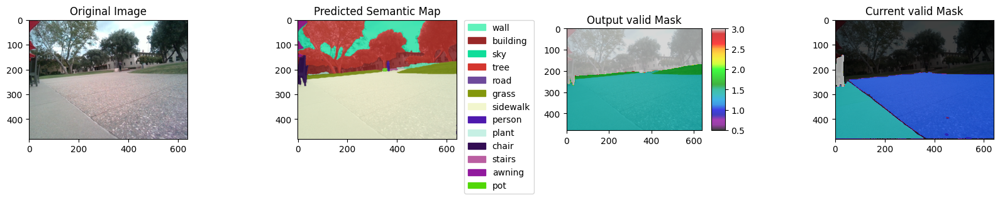

timestamp: 1712270521.664165.npy


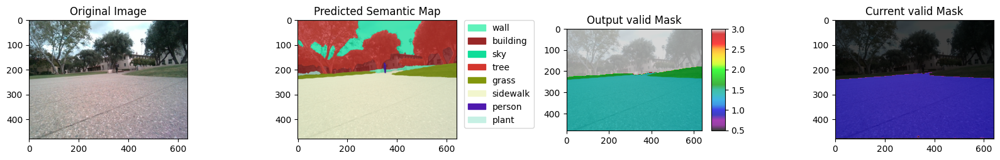

timestamp: 1712270553.575116.npy


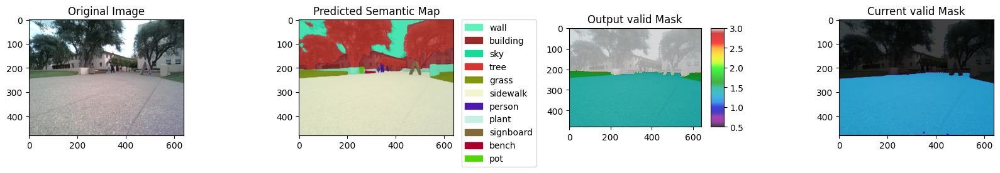

timestamp: 1712270554.642263.npy


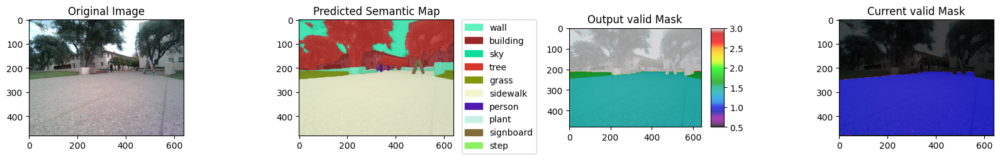

timestamp: 1712270598.825646.npy


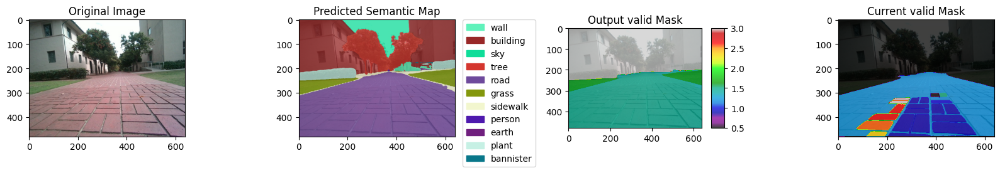

timestamp: 1712270629.577167.npy


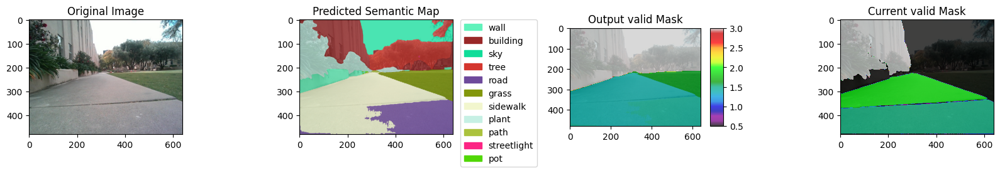

timestamp: 1712270633.810175.npy


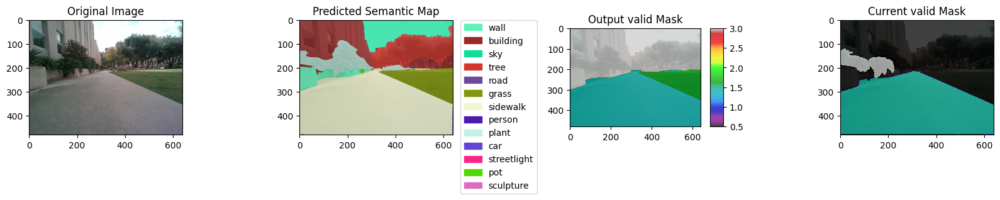

timestamp: 1712270635.243503.npy


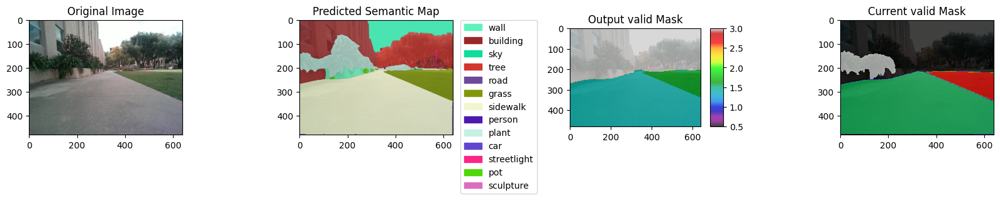

timestamp: 1712270638.652380.npy


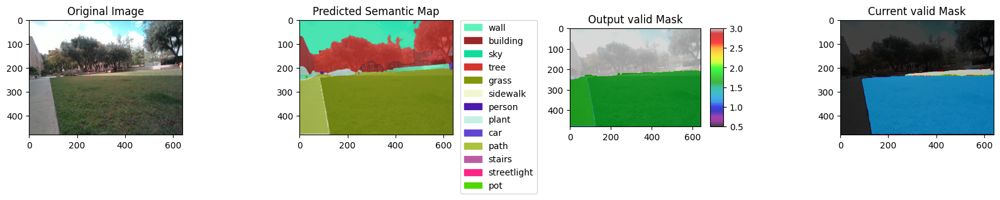

timestamp: 1712270642.850986.npy


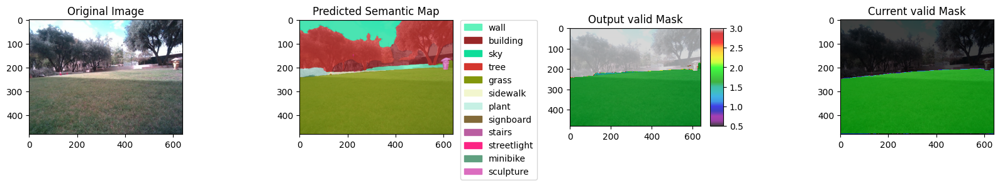

timestamp: 1712270649.183882.npy


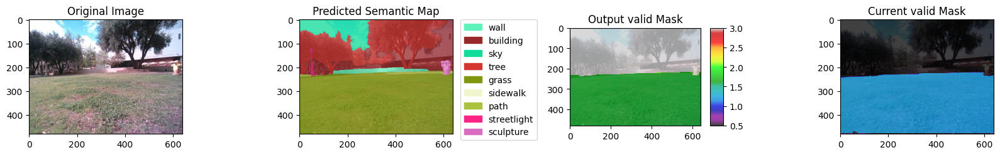

timestamp: 1712270655.352428.npy


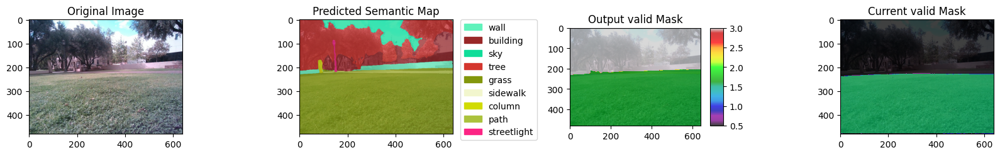

timestamp: 1712270670.469059.npy


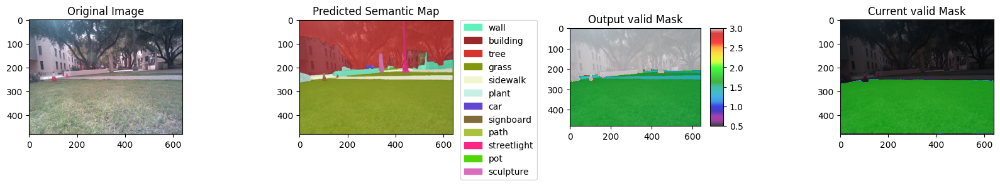

timestamp: 1712270681.762378.npy


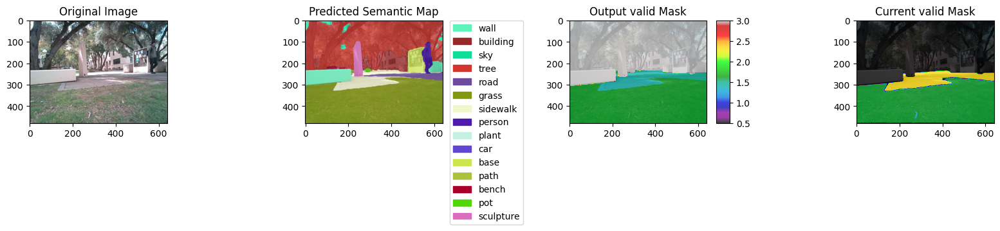

timestamp: 1712270685.939130.npy


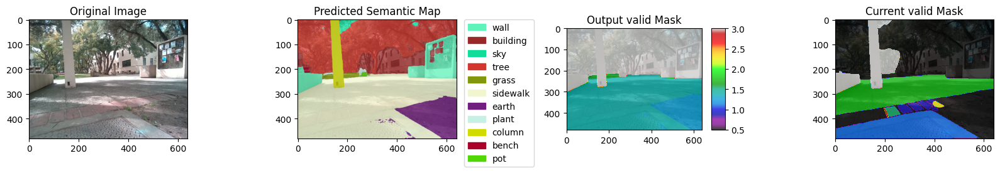

timestamp: 1712271112.755008.npy


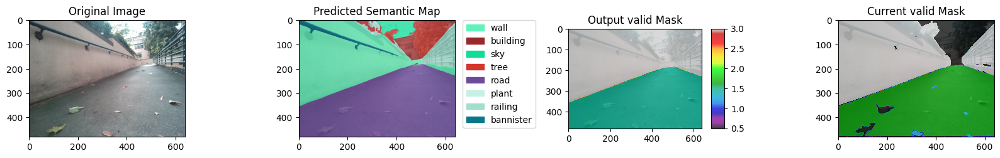

timestamp: 1712271128.594711.npy


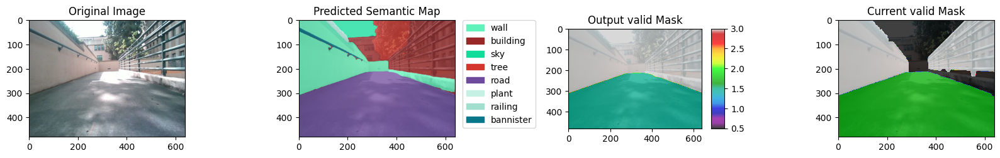

timestamp: 1712271148.537552.npy


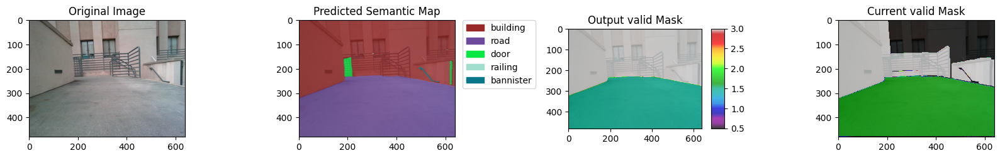

timestamp: 1712271175.049891.npy


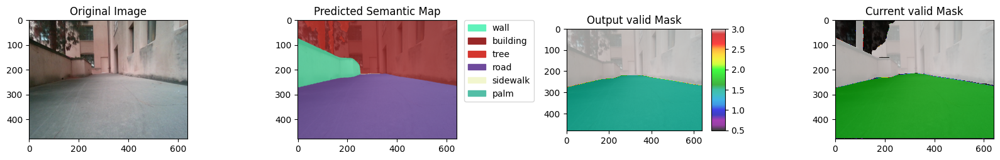

timestamp: 1712271187.256938.npy


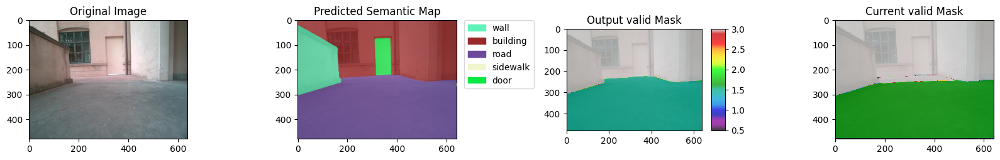

timestamp: 1712271209.304820.npy


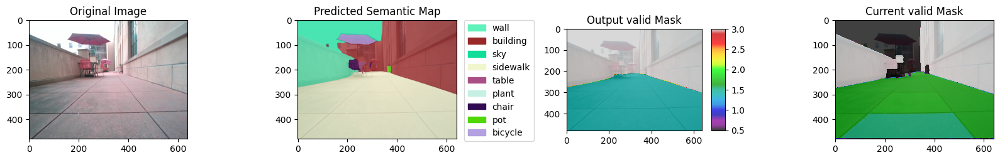

timestamp: 1712271243.979778.npy


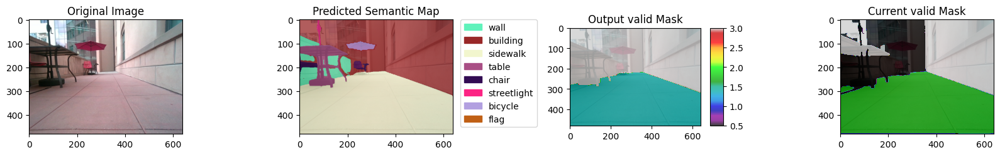

timestamp: 1712271248.615004.npy


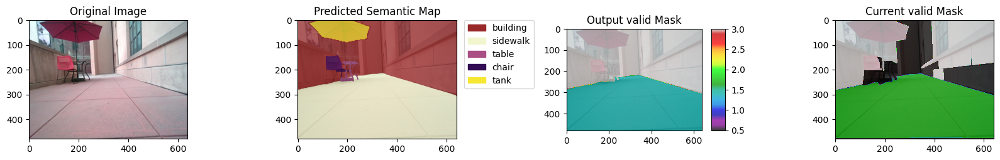

timestamp: 1712271259.554033.npy


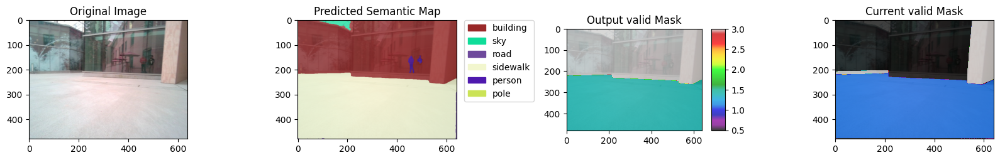

timestamp: 1712271267.190793.npy


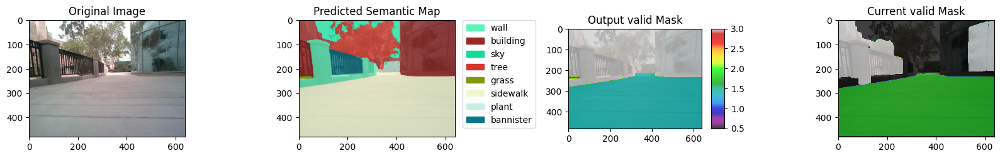

timestamp: 1712271280.369754.npy


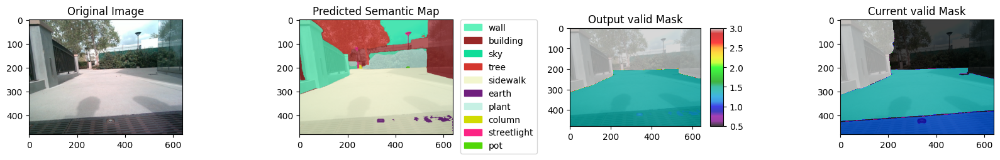

timestamp: 1712271301.305719.npy


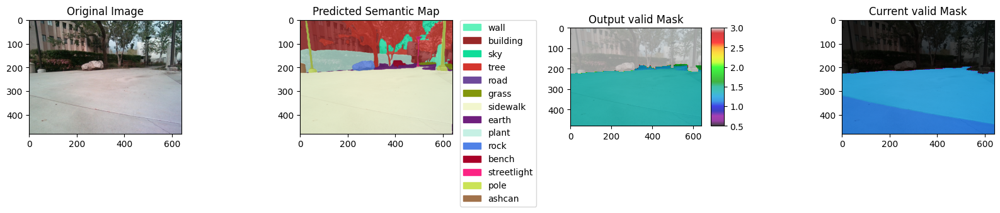

timestamp: 1712271307.874850.npy


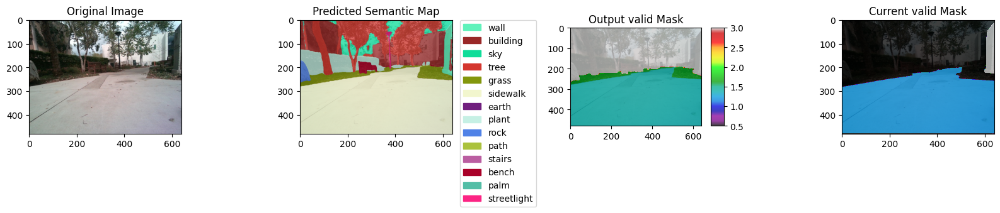

timestamp: 1712271316.678891.npy


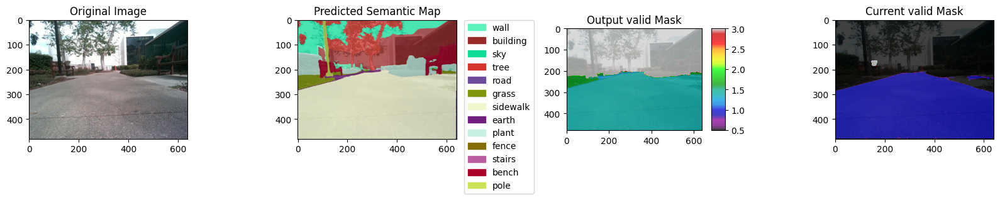

timestamp: 1712271325.682886.npy


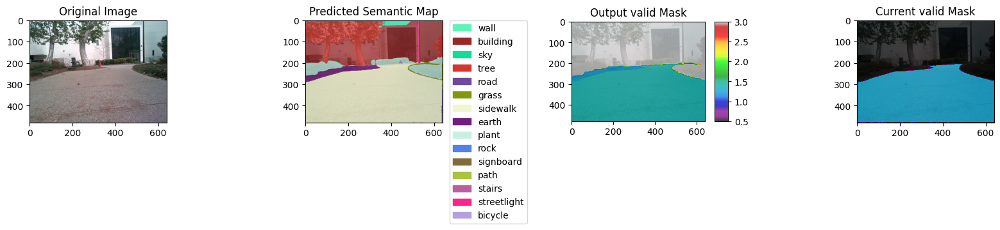

In [5]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
selected_names=[
    "grass",
    "sidewalk",
    "road",
    "earth",
    "path"
]
clear_folder(os.path.join(valid_folder_manually, "mask"))
selected_ids = [int(key) for key, value in id_to_label_name.items() if value in selected_names]
print(selected_ids)
for label_file in label_files:
    labels = np.load(label_file)
    print("timestamp:",os.path.basename(label_file))
    img = Image.open(check_file_path(imaege_folder,os.path.basename(label_file).replace(".npy",".jpg")))
    mask = np.load(check_file_path(valid_folder,"mask",os.path.basename(label_file)))
    output_image = np.ones(labels.shape, dtype=np.float32) * cot_no_traversable
    for i in range(len(selected_ids)):
        output_image[labels == selected_ids[i]] = mean[selected_ids[i]]
    fig, ax = plt.subplots(1, 4, figsize=(16, 3))
    ax[0].imshow(img)
    ax[0].set_title('Original Image')
    ax[2].imshow(img)
    ax[2].imshow(output_image, alpha=0.75,cmap='nipy_spectral', vmin=0.5, vmax=3)
    ax[2].set_title('Output valid Mask')
    ax[3].imshow(img)
    im2 = ax[3].imshow(mask, alpha=0.75,cmap='nipy_spectral', vmin=0.5, vmax=3)
    ax[3].set_title('Current valid Mask')    
    divider = make_axes_locatable(ax[2])
    cax = divider.append_axes('right', size='10%', pad=0.15)
    fig.colorbar(im2, cax=cax, orientation='vertical')
    plot_predicted_semantic_map(img,labels,ax[1])
    # save as image array
    fig.tight_layout()
    fig.canvas.draw()
    plt.show()

    # save output
    np.save(os.path.join(valid_folder_manually, 'mask', os.path.basename(label_file)), output_image)
    
    # image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')   
    # image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    # break

In [8]:
import shutil
import os

# Define the source and destination folders


# Copy the RGB, depth, confidence, and segmentation images to the destination folder
shutil.copytree(os.path.join(valid_folder, "rgb"), os.path.join(valid_folder_manually, "rgb"))
shutil.copytree(os.path.join(valid_folder, "depth"), os.path.join(valid_folder_manually, "depth"))
shutil.copytree(os.path.join(valid_folder, "confidence"), os.path.join(valid_folder_manually, "confidence"))
shutil.copytree(os.path.join(valid_folder, "segmentation"), os.path.join(valid_folder_manually, "segmentation"))


'datasets/dataset-2024-04-25_14-58-19\\test_manually_labelled\\segmentation'